___
# Import Library
___

In [1]:
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import matplotlib
import seaborn as sns

import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, iplot
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
import plotly.io as pio

import folium
from branca import colormap as cm

import sqlalchemy as db
import os
from dotenv import load_dotenv
from geopy.geocoders import Nominatim

import itertools
import io
from PIL import Image

In [2]:
pd.options.display.max_columns = 500

In [3]:
load_dotenv()

True

In [4]:
init_notebook_mode(connected=True)

In [5]:
def save_img(m, filename):
    img_data = m._to_png(5)
    img = Image.open(io.BytesIO(img_data))
    img.save(filename)

In [6]:
PATH = 'Dashboard/Airbnb/static/assets/img/portfolio/'

pio.write_html(fig, PATH+'insight-1.html')

___
# Business Problems
___

Who doesn't like to travel? Traveling is a such fun activity, coming into new place and experience many new things. It is a part of crucial aspect in life as it's the best way to escape from hectic and busy schedule. It also improves the mental and physical health while it's a good remedy for stress, anxiety and depression. As part of travelling, deciding accomodation or where you should sleep and charge your body is definitely important thing to decide. One of the choice to spend your night, apart from conventional hotel is Airbnb.

Airbnb is an American vacation rental online marketplace company based in San Francisco, California. Airbnb maintains and hosts a marketplace, accessible to consumers on its website or via an app. Through the service, users can arrange lodging, primarily homestays, and tourism experiences or list their properties for rental. Airbnb does not own any of the listed properties; instead, it profits by receiving commission from each booking. 

Singapore, one of developed country in Asia, make 4.1% of its national GDP from tourism industry alone and has been one of the most visited country in Asia resulting in thousand of Airbnb listings in Singapore (around 4000+ listings). It can be troublesome to choose one befitting your needs and budget. This also becomes problem for owner property who wants to register their new property in Airbnb since they may find it hard to price their property.

Here's where machine learning help to solve those problems. Predicting price of property, or in this case Airbnb listing, could be quite challenging since there are various factors need to be measured and calculated in order to get price accurately. In this project, we will do end-to-end machine learning project, starting from cleaning the dataset, do exploratory data analysis to get some insights, use machine learning model to predict Airbnb listing price and deploy our best model by creating dashboard.   

___
# Load Datasets
___

In [7]:
engine = db.create_engine(os.getenv('db-uri'))

In [8]:
meta = db.MetaData()
meta.reflect(engine)

In [9]:
df_dict = dict()

In [10]:
with engine.connect() as con:
    for table in meta.tables.keys():
        query = db.select([meta.tables[table]])
        all_data = con.execute(query).fetchall()
        df_dict[table] = pd.DataFrame(all_data, columns=meta.tables[table].c.keys())

In [11]:
for key in df_dict:
    display(key)
    display(df_dict[key].head())

'reviews'

,listing_id,id,date,reviewer_id,reviewer_name,comments
0,49091,8243238,2013-10-21,8557223,Jared,Fran was absolutely gracious and welcoming. Ma...
1,50646,11909864,2014-04-18,1356099,James,A comfortable room in a smart condo developmen...
2,50646,13823948,2014-06-05,15222393,Welli,Stayed over at Sujatha's house for 3 good nigh...
3,50646,15117222,2014-07-02,5543172,Cyril,It's been a lovely stay at Sujatha's. The room...
4,50646,15426462,2014-07-08,817532,Jake,"We had a great experience. A nice place, an am..."


'neighbourhood'

,neighbourhood_group,neighbourhood
0,Central Region,Bishan
1,Central Region,Bukit Merah
2,Central Region,Bukit Timah
3,Central Region,Downtown Core
4,Central Region,Geylang


'listings'

,id,listing_url,name,description,neighborhood_overview,picture_url,host_id,host_url,host_name,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_thumbnail_url,host_picture_url,host_neighbourhood,host_listings_count,host_total_listings_count,host_verifications,host_has_profile_pic,host_identity_verified,neighbourhood_cleansed,neighbourhood_group_cleansed,latitude,longitude,property_type,room_type,accommodates,bedrooms,beds,price,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,has_availability,availability_30,availability_60,availability_90,availability_365,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month,total_bathrooms,bathrooms_type,Air Conditioning,BBQ Utensils,Baby and Children Equipments,Bathtub,Beach Essentials,Breakfast,Building Staff,Cleaning Before Checkout,Cleaning Equipments,Clothing Equipments,Coffee Maker,Cutlery,Dedicated Workspace,Door Lock,Dryer,EV Charger,Elevator,Entertainment,Essentials,Ethernet Connection,"Extra pillows, blankets or bed-linen",Fan,Fire Safety Equipments,Fireplace,First Aid Kit,Free Parking,Gym,Heating,Host Greets You,Hot Tub,Hot Water,Kitchen Utensils,Kitchen/Dining Area,Laundromat Nearby,Living Room,Lockbox,Long Term Stays Allowed,Luggage Dropoff Allowed,Outdoor Space,Paid Parking,Pool,Private Entrance,Refrigerator/Freezer,Sauna,Single level Home,Ski-in/Ski-out,TV,Toilet Equipments,Washer,Water Body Access
0,49091,https://www.airbnb.com/rooms/49091,COZICOMFORT LONG TERM STAY ROOM 2,<b>The space</b><br />This is Room No. 2.(avai...,None,https://a0.muscache.com/pictures/24485541/67b0...,266763,https://www.airbnb.com/users/show/266763,Francesca,2010-10-20,Singapore,I am a private tutor by profession. My husband...,within a day,100.0,NaN,False,https://a0.muscache.com/im/pictures/user/2628b...,https://a0.muscache.com/im/pictures/user/2628b...,Woodlands,2.0,2.0,"['email', 'phone', 'facebook', 'reviews', 'jum...",True,True,Woodlands,North Region,1.44255,103.79580,Private room in apartment,Private room,1,1.0,1.0,79,180,360,180,180,360,360,180.0,360.0,True,30,60,90,365,1,0,0,2013-10-21,2013-10-21,94.0,10.0,10.0,10.0,10.0,8.0,8.0,False,2,0,2,0,0.01,1.0,bath,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0
1,50646,https://www.airbnb.com/rooms/50646,Pleasant Room along Bukit Timah,Fully furnished bedroom with a nice view on th...,The serenity & quiet surrounding makes it an i...,https://a0.muscache.com/pictures/36342984/670d...,227796,https://www.airbnb.com/users/show/227796,Sujatha,2010-09-08,"Singapore, Singapore","I am a working professional, living in Singapo...",a few days or more,0.0,NaN,False,https://a0.muscache.com/im/pictures/user/8fd2c...,https://a0.muscache.com/im/pictures/user/8fd2c...,Bukit Timah,1.0,1.0,"['email', 'phone', 'facebook', 'reviews', 'off...",True,True,Bukit Timah,Central Region,1.33235,103.78521,Private room in apartment,Private room,2,1.0,1.0,80,90,730,90,90,730,730,90.0,730.0,True,30,60,90,365,18,0,0,2014-04-18,2014-12-26,91.0,9.0,10.0,10.0,10.0,9.0,9.0,False,1,0,1,0,0.22,1.0,bath,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,1,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,0
2,56334,https://www.airbnb.com/rooms/56334,COZICOMFORT,<b>The space</b><br />This is Room no. 1. USD7...,None,https://a0.muscache.com/pictures/20783922/1966...,266763,https://www.airbnb.com/users/show/266763,Francesca,2010-10-20,Singapore,I am a private tutor by profession

'calendar'

,listing_id,date,available,price,adjusted_price,minimum_nights,maximum_nights
0,1678754,2020-12-30,False,257,257,1.0,30.0
1,4450681,2021-01-02,True,320,320,7.0,999.0
2,4450681,2021-01-03,True,320,320,7.0,999.0
3,4450681,2021-01-04,True,320,320,7.0,999.0
4,4450681,2021-01-05,True,200,200,7.0,999.0


___
# Exploratory Data Analysis
___

## How is the price distribution of Singapore Airbnb?

In [51]:
fig = go.Figure()
fig.add_trace(
    go.Histogram(x=df_dict['listings']['price'])
)

fig.update_layout(
    title_text='Price Distributions',
    title_x=0.5,
    xaxis_title_text='Price',
    yaxis_title_text='Count',
)
fig.show()

In [60]:
percentiles = [(p, round(p/100*len(df_dict['listings']['price'])),
                np.percentile(df_dict['listings']['price'], p)) for p in np.linspace(10, 100, 10)]

In [61]:
pd.DataFrame(percentiles, columns=['Percentiles', 'Count', 'Value'])

,Percentiles,Count,Value
0,10.0,437,38.0
1,20.0,874,55.0
2,30.0,1312,69.0
3,40.0,1749,89.0
4,50.0,2186,114.0
5,60.0,2623,140.0
6,70.0,3060,161.0
7,80.0,3498,200.0
8,90.0,3935,290.0
9,100.0,4372,3000.0


## What is the maximum and minimum price of Singapore Airbnb listings?

In [13]:
df_dict['listings'][df_dict['listings']['price'] == df_dict['listings']['price'].max()]

,id,listing_url,name,description,neighborhood_overview,picture_url,host_id,host_url,host_name,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_thumbnail_url,host_picture_url,host_neighbourhood,host_listings_count,host_total_listings_count,host_verifications,host_has_profile_pic,host_identity_verified,neighbourhood_cleansed,neighbourhood_group_cleansed,latitude,longitude,property_type,room_type,accommodates,bedrooms,beds,price,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,has_availability,availability_30,availability_60,availability_90,availability_365,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month,total_bathrooms,bathrooms_type,Air Conditioning,BBQ Utensils,Baby and Children Equipments,Bathtub,Beach Essentials,Breakfast,Building Staff,Cleaning Before Checkout,Cleaning Equipments,Clothing Equipments,Coffee Maker,Cutlery,Dedicated Workspace,Door Lock,Dryer,EV Charger,Elevator,Entertainment,Essentials,Ethernet Connection,"Extra pillows, blankets or bed-linen",Fan,Fire Safety Equipments,Fireplace,First Aid Kit,Free Parking,Gym,Heating,Host Greets You,Hot Tub,Hot Water,Kitchen Utensils,Kitchen/Dining Area,Laundromat Nearby,Living Room,Lockbox,Long Term Stays Allowed,Luggage Dropoff Allowed,Outdoor Space,Paid Parking,Pool,Private Entrance,Refrigerator/Freezer,Sauna,Single level Home,Ski-in/Ski-out,TV,Toilet Equipments,Washer,Water Body Access
1015,17794853,https://www.airbnb.com/rooms/17794853,Clean and spacious mansion,My place is close to Resorts World Sentosa. Yo...,None,https://a0.muscache.com/pictures/cc1682ea-054b...,121584052,https://www.airbnb.com/users/show/121584052,Amara Sanctuary,2017-03-19,Singapore,Amara Sanctuary Resort Sentosa is a contempora...,within a day,60.0,0.0,False,https://a0.muscache.com/im/pictures/user/3d51c...,https://a0.muscache.com/im/pictures/user/3d51c...,Sentosa,6.0,6.0,"['email', 'phone', 'manual_online', 'manual_of...",True,True,Southern Islands,Central Region,1.253,103.82276,Entire place,Entire home/apt,4,2.0,2.0,3000,10,365,10,10,365,365,10.0,365.0,True,27,57,87,88,0,0,0,NaT,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,6,3,3,0,NaN,2.0,bath,1,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,1,0,1,1,0,0,1,0,1,1,1,0,0,1,0,0,1,0,0,0,0,0,0,0,1,1,0,0,0,0,1,1,1,0


In [14]:
df_dict['listings'][df_dict['listings']['price'] == df_dict['listings']['price'].min()]

,id,listing_url,name,description,neighborhood_overview,picture_url,host_id,host_url,host_name,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_thumbnail_url,host_picture_url,host_neighbourhood,host_listings_count,host_total_listings_count,host_verifications,host_has_profile_pic,host_identity_verified,neighbourhood_cleansed,neighbourhood_group_cleansed,latitude,longitude,property_type,room_type,accommodates,bedrooms,beds,price,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,has_availability,availability_30,availability_60,availability_90,availability_365,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month,total_bathrooms,bathrooms_type,Air Conditioning,BBQ Utensils,Baby and Children Equipments,Bathtub,Beach Essentials,Breakfast,Building Staff,Cleaning Before Checkout,Cleaning Equipments,Clothing Equipments,Coffee Maker,Cutlery,Dedicated Workspace,Door Lock,Dryer,EV Charger,Elevator,Entertainment,Essentials,Ethernet Connection,"Extra pillows, blankets or bed-linen",Fan,Fire Safety Equipments,Fireplace,First Aid Kit,Free Parking,Gym,Heating,Host Greets You,Hot Tub,Hot Water,Kitchen Utensils,Kitchen/Dining Area,Laundromat Nearby,Living Room,Lockbox,Long Term Stays Allowed,Luggage Dropoff Allowed,Outdoor Space,Paid Parking,Pool,Private Entrance,Refrigerator/Freezer,Sauna,Single level Home,Ski-in/Ski-out,TV,Toilet Equipments,Washer,Water Body Access
1686,24849782,https://www.airbnb.com/rooms/24849782,TS,For long-term lease. Minimum 6 months.<br /><b...,Quiet and Central area,https://a0.muscache.com/pictures/5fb30e50-28e4...,187844948,https://www.airbnb.com/users/show/187844948,Ben,2018-05-04,SG,None,a few days or more,0.0,NaN,False,https://a0.muscache.com/im/pictures/user/c53c6...,https://a0.muscache.com/im/pictures/user/c53c6...,Ang Mo Kio,0.0,0.0,"['email', 'phone']",True,False,Ang Mo Kio,North-East Region,1.37003,103.84241,Private room in house,Private room,1,1.0,1.0,13,180,540,180,180,540,540,180.0,540.0,False,0,0,0,0,0,0,0,NaT,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,1,0,1,0,NaN,1.0,shared bath,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,1,1,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,0


## Is there any specific area with more listings in Singapore?

In [15]:
geocoder = Nominatim(user_agent='airbnb_sg')
result = geocoder.geocode('Singapore')
sg_center = (result.latitude, result.longitude)

In [16]:
colors = ["#ffbe0b","#fb5607","#ff006e","#8338ec","#3a86ff"]
color_code = {area:colors[i] for i, area in enumerate(df_dict['neighbourhood'].neighbourhood_group.unique())}

In [17]:
def add_categorical_legend(folium_map, title, colors, labels):
    if len(colors) != len(labels):
        raise ValueError("colors and labels must have the same length.")

    color_by_label = dict(zip(labels, colors))
    
    legend_categories = ""     
    for label, color in color_by_label.items():
        legend_categories += f"<li><span style='background:{color}'></span>{label}</li>"
        
    legend_html = f"""
    <div id='maplegend' class='maplegend'>
      <div class='legend-title'>{title}</div>
      <div class='legend-scale'>
        <ul class='legend-labels'>
        {legend_categories}
        </ul>
      </div>
    </div>
    """
    script = f"""
        <script type="text/javascript">
        var oneTimeExecution = (function() {{
                    var executed = false;
                    return function() {{
                        if (!executed) {{
                             var checkExist = setInterval(function() {{
                                       if ((document.getElementsByClassName('leaflet-bottom leaflet-left').length) || (!executed)) {{
                                          document.getElementsByClassName('leaflet-bottom leaflet-left')[0].style.display = "flex"
                                          document.getElementsByClassName('leaflet-bottom leaflet-left')[0].style.flexDirection = "column"
                                          document.getElementsByClassName('leaflet-bottom leaflet-left')[0].innerHTML += `{legend_html}`;
                                          clearInterval(checkExist);
                                          executed = true;
                                       }}
                                    }}, 100);
                        }}
                    }};
                }})();
        oneTimeExecution()
        </script>
      """
   

    css = """
    <style type='text/css'>
      .maplegend {
        z-index:9999;
        float:right;
        background-color: rgba(255, 255, 255, 1);
        border-radius: 5px;
        border: 2px solid #bbb;
        padding: 10px;
        font-size:12px;
        positon: relative;
      }
      .maplegend .legend-title {
        text-align: left;
        margin-bottom: 5px;
        font-weight: bold;
        font-size: 90%;
        }
      .maplegend .legend-scale ul {
        margin: 0;
        margin-bottom: 5px;
        padding: 0;
        float: left;
        list-style: none;
        }
      .maplegend .legend-scale ul li {
        font-size: 80%;
        list-style: none;
        margin-left: 0;
        line-height: 18px;
        margin-bottom: 2px;
        }
      .maplegend ul.legend-labels li span {
        display: block;
        float: left;
        height: 16px;
        width: 30px;
        margin-right: 5px;
        margin-left: 0;
        border: 0px solid #ccc;
        }
      .maplegend .legend-source {
        font-size: 80%;
        color: #777;
        clear: both;
        }
      .maplegend a {
        color: #777;
        }
    </style>
    """

    folium_map.get_root().header.add_child(folium.Element(script + css))

    return folium_map

In [106]:
m = folium.Map(location=sg_center, tiles='CartoDB dark_matter', zoom_start=11, min_zoom=11)

for idx, listing in df_dict['listings'].iterrows():
    html = f'''
        <p style="font-family:georgia,garamond,serif;">
            <span style="font-size:25px;color:#D00000;"><i><b>{listing['name']}</b></i></span>
            <br><br>
            <img height=200px align="right" src={listing['picture_url']}>
            <br>
            <span style="font-size:16px;">Neighbourhood Group:<br><b>{listing['neighbourhood_group_cleansed']}</b></span>
            <br><br>
            <span style="font-size:16px;">Neighbourhood:<br><b>{listing['neighbourhood_cleansed']}</b></span>
            <br><br>
            <span style="font-size:16px;">Price:<br><b>{listing['price']}</b></span>
        </p>
        '''
    iframe = folium.IFrame(html)
    popup = folium.Popup(iframe, min_width=435, max_width=700, min_height=435, max_height=700)
    folium.CircleMarker(location=(listing.latitude, listing.longitude), radius=3, 
                        fill_color=color_code[listing['neighbourhood_group_cleansed']], color=None,
                        fill_opacity=0.5, popup=popup
                       ).add_to(m)
    
m = add_categorical_legend(m, 'Neighbourhood Group', colors=color_code.values(), labels=color_code.keys())
folium.LayerControl().add_to(m)
m

In [107]:
m.save('Dashboard/Airbnb/templates/insight-2-map.html')

In [108]:
save_img(m, PATH+'insight-2-map.png')

In [19]:
sankey_data = (df_dict['listings']
               .groupby(['neighbourhood_group_cleansed', 'neighbourhood_cleansed'])
               .agg(Count=('id', 'count'))).reset_index()
sankey_data

,neighbourhood_group_cleansed,neighbourhood_cleansed,Count
0,Central Region,Bishan,36
1,Central Region,Bukit Merah,219
2,Central Region,Bukit Timah,68
3,Central Region,Downtown Core,302
4,Central Region,Geylang,416
5,Central Region,Kallang,595
6,Central Region,Marina South,2
7,Central Region,Marine Parade,53
8,Central Region,Museum,20
9,Central Region,Newton,68


In [20]:
neigh_group_map = {x:idx for idx, x in enumerate(sankey_data.neighbourhood_group_cleansed.unique())}
colors = ["#ffbe0b","#fb5607","#ff006e","#8338ec","#3a86ff"]

sankey_data['neigh_group'] = sankey_data.neighbourhood_group_cleansed.map(neigh_group_map)
sankey_data['neigh'] = [x+5 for x in sankey_data.index.tolist()]
sankey_data['neigh_colors'] = [colors[x] for x in sankey_data.neigh_group]
sankey_data

,neighbourhood_group_cleansed,neighbourhood_cleansed,Count,neigh_group,neigh,neigh_colors
0,Central Region,Bishan,36,0,5,#ffbe0b
1,Central Region,Bukit Merah,219,0,6,#ffbe0b
2,Central Region,Bukit Timah,68,0,7,#ffbe0b
3,Central Region,Downtown Core,302,0,8,#ffbe0b
4,Central Region,Geylang,416,0,9,#ffbe0b
5,Central Region,Kallang,595,0,10,#ffbe0b
6,Central Region,Marina South,2,0,11,#ffbe0b
7,Central Region,Marine Parade,53,0,12,#ffbe0b
8,Central Region,Museum,20,0,13,#ffbe0b
9,Central Region,Newton,68,0,14,#ffbe0b


In [21]:
data = go.Sankey(
    node = dict(pad=15, 
                thickness=20, 
                line=dict(color = "black", width = 0.5), 
                label=(sankey_data.neighbourhood_group_cleansed.unique().tolist() + 
                       sankey_data.neighbourhood_cleansed.unique().tolist()),
                customdata=(sankey_data.neighbourhood_group_cleansed.unique().tolist() + 
                            sankey_data.neighbourhood_cleansed.unique().tolist()),
                color=["#ffbe0b","#fb5607","#ff006e","#8338ec","#3a86ff"] + sankey_data.neigh_colors.tolist(),
                hovertemplate='%{customdata} has total listing of %{value}<extra></extra>',
               ),
    link = dict(source=sankey_data.neigh_group.tolist(), 
                target=sankey_data.neigh.tolist(), 
                value=sankey_data.Count.tolist(),
                customdata=(sankey_data.neighbourhood_group_cleansed.unique().tolist() + 
                            sankey_data.neighbourhood_cleansed.unique().tolist()),
                hovertemplate=('Neighbourhood Group: <b>%{source.customdata}</b><br />' + 
                               'Neighbourhood Name: <b>%{target.customdata}</b><br />')
               ),
)

fig = go.Figure(data=[data])
fig.update_layout(font_size=10, height=1000, 
                  title_text='Number of Listings in Each Neighbourhood', title_x=0.5)
fig.show()

In [101]:
grouped = (df_dict['listings']
           .groupby(['neighbourhood_group_cleansed'])
           .agg(Count=('id', 'count'))
           .sort_values('Count', ascending=False))
grouped['Percentage'] = grouped['Count'] / len(df_dict['listings']) * 100
grouped

,Count,Percentage
neighbourhood_group_cleansed,,
Central Region,3548,81.152790
West Region,276,6.312900
East Region,246,5.626715
North-East Region,169,3.865508
North Region,133,3.042086


In [100]:
grouped = (df_dict['listings']
           .groupby(['neighbourhood_group_cleansed', 'neighbourhood_cleansed'])
           .agg(Count=('id', 'count'))
           .sort_values('Count', ascending=False))
grouped['Percentage'] = grouped['Count'] / len(df_dict['listings']) * 100
grouped

Count  Percentage
neighbourhood_group_cleansed neighbourhood_cleansed                    
Central Region               Kallang                    595   13.609332
                             Geylang                    416    9.515096
                             Novena                     398    9.103385
                             Outram                     368    8.417200
                             Rochor                     320    7.319305
                             Downtown Core              302    6.907594
                             Bukit Merah                219    5.009149
East Region                  Bedok                      177    4.048490
Central Region               Queenstown                 151    3.453797
                             Singapore River            150    3.430924
                             River Valley               146    3.339433
                             Tanglin                     82    1.875572
West Region                  Clementi                    78    1.784081
Central Region               Orchard                     75    1.715462
                             Newton                      68    1.555352
                             Bukit Timah                 68    1.555352
West Region                  Jurong West                 63    1.440988
Central Region               Toa Payoh                   58    1.326624
West Region                  Jurong East                 57    1.303751
North-East Region            Hougang                     57    1.303751
Central Region               Marine Parade               53    1.212260
North Region                 Woodlands                   49    1.120769
North-East Region            Serangoon                   42    0.960659
East Region                  Tampines                    41    0.937786
North Region                 Sembawang                   38    0.869167
Central Region               Bishan                      36    0.823422
North Region                 Yishun                      31    0.709058
West Region                  Bukit Batok                 31    0.709058
East Region                  Pasir Ris                   27    0.617566
North-East Region            Ang Mo Kio                  27    0.617566
West Region                  Choa Chu Kang               23    0.526075
North-East Region            Sengkang                    23    0.526075
Central Region               Southern Islands            21    0.480329
West Region                  Bukit Panjang               21    0.480329
North-East Region            Punggol                     20    0.457457
Central Region               Museum                      20    0.457457
North Region                 Central Water Catchment     12    0.274474
West Region                  Western Water Catchment      2    0.045746
North Region                 Mandai                       2    0.045746
Central Region               Marina South                 2    0.045746
North Region                 Sungei Kadut                 1    0.022873
West Region                  Pioneer                      1    0.022873
East Region                  Changi                       1    0.022873

## Is there any neighbourhood group that has higher listings price?

In [22]:
index = np.linspace(df_dict['listings'].price.min(), df_dict['listings'].price.max(), 10)
colormap = cm.LinearColormap(colors=['#'+i for i in ("f72585","b5179e","7209b7","560bad","480ca8",
                                                     "3a0ca3","3f37c9","4361ee","4895ef","4cc9f0")][::-1], 
                             index=index, vmin=index[0], vmax=index[-1], 
                             caption='Price')

In [109]:
m = folium.Map(location=sg_center, tiles='CartoDB positron', zoom_start=11, min_zoom=11)

for idx, listing in df_dict['listings'].sort_values('price').iterrows():
    html = f'''
        <p style="font-family:georgia,garamond,serif;">
            <span style="font-size:25px;color:#D00000;"><i><b>{listing['name']}</b></i></span>
            <br><br>
            <img height=200px align="right" src={listing['picture_url']}>
            <br>
            <span style="font-size:16px;">Neighbourhood Group:<br><b>{listing['neighbourhood_group_cleansed']}</b></span>
            <br><br>
            <span style="font-size:16px;">Neighbourhood:<br><b>{listing['neighbourhood_cleansed']}</b></span>
            <br><br>
            <span style="font-size:16px;">Price:<br><b>{listing['price']}</b></span>
        </p>
        '''
    iframe = folium.IFrame(html)
    popup = folium.Popup(iframe, min_width=435, max_width=700, min_height=435, max_height=700)
    folium.CircleMarker(location=(listing.latitude, listing.longitude), radius=3, 
                        fill_color=colormap(listing['price']), color=None,
                        fill_opacity=0.5, popup=popup
                       ).add_to(m)
colormap.add_to(m)    
m

In [110]:
m.save('Dashboard/Airbnb/templates/insight-3-map.html')

In [111]:
save_img(m, PATH+'insight-3-map.png')

In [24]:
box_data = df_dict['listings']
neigh_group_cm = {x:y for x,y in zip(neigh_group_map, colors)}
fig = go.Figure()
for idx, neigh_group in enumerate(box_data.neighbourhood_group_cleansed.unique()):
    fig.add_trace(
        go.Box(x=box_data[box_data.neighbourhood_group_cleansed == neigh_group]['price'], 
               name=neigh_group, marker_color=neigh_group_cm[neigh_group])
    )
fig.update_layout(
    title_text='Price Boxplot For Each Neighbourhood Group',
    title_x=0.5,
    xaxis_title_text='Price', 
    xaxis_zeroline=False)
fig.show()

In [25]:
by_neigh = df_dict['listings'].groupby('neighbourhood_group_cleansed')

fig = go.Figure()
for neigh in ['West Region', 'East Region', 'Central Region', 'North-East Region', 'North Region'][::-1]:
    fig.add_trace(go.Violin(x=by_neigh.get_group(neigh)['price'], 
                            line_color=neigh_group_cm[neigh], 
                            name=neigh, showlegend=False))

fig.update_traces(orientation='h', side='positive', width=3, points=False)
fig.update_layout(
    xaxis_showgrid=False, 
    xaxis_zeroline=False,  
    title_text='Price Distribution For Each Neighbourhood Group',
    title_x=0.5,
    xaxis_title_text='Price')
fig.show()

## Is there any room type that has higher price?

In [35]:
by_room = df_dict['listings'].groupby('room_type')

fig = go.Figure()
for room in ['Entire home/apt', 'Private room', 'Hotel room', 'Shared room'][::-1]:
    fig.add_trace(go.Violin(x=by_room.get_group(room)['price'], 
                            name=room, showlegend=False))

fig.update_traces(orientation='h', side='positive', width=3, points=False)
fig.update_layout(
    xaxis_showgrid=False, 
    xaxis_zeroline=False,  
    title_text='Price Distribution For Each Room Type',
    title_x=0.5,
    xaxis_title_text='Price')
fig.show()

In [129]:
by_room_count = by_room.agg(Count=('id', 'count')).reset_index().sort_values('Count', ascending=False)
data = go.Bar(x=by_room_count['room_type'], y=by_room_count['Count'], 
              text=by_room_count['Count'], textposition='auto', 
              marker_color=['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728'])
layout = go.Layout(
    title_text='Countplot For Room Type',
    title_x=0.5)
fig = go.Figure(data=data, layout=layout)
fig.show()

## Is there any specific amenities that will boost price?

In [36]:
amenities = pd.concat([df_dict['listings'].iloc[:, -50:], df_dict['listings']['price']], axis=1)
amenities

,Air Conditioning,BBQ Utensils,Baby and Children Equipments,Bathtub,Beach Essentials,Breakfast,Building Staff,Cleaning Before Checkout,Cleaning Equipments,Clothing Equipments,Coffee Maker,Cutlery,Dedicated Workspace,Door Lock,Dryer,EV Charger,Elevator,Entertainment,Essentials,Ethernet Connection,"Extra pillows, blankets or bed-linen",Fan,Fire Safety Equipments,Fireplace,First Aid Kit,Free Parking,Gym,Heating,Host Greets You,Hot Tub,Hot Water,Kitchen Utensils,Kitchen/Dining Area,Laundromat Nearby,Living Room,Lockbox,Long Term Stays Allowed,Luggage Dropoff Allowed,Outdoor Space,Paid Parking,Pool,Private Entrance,Refrigerator/Freezer,Sauna,Single level Home,Ski-in/Ski-out,TV,Toilet Equipments,Washer,Water Body Access,price
0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,79
1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,1,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,0,80
2,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,66
3,1,0,1,0,0,0,0,0,0,1,0,0,1,1,1,0,0,0,1,1,0,0,1,0,0,1,0,0,0,1,1,0,1,0,0,0,1,1,1,0,0,1,0,0,0,0,1,1,1,0,174
4,1,0,0,0,0,0,0,0,0,0,1,0,0,1,1,0,0,0,1,1,0,0,1,0,0,1,0,0,0,1,1,0,1,0,0,0,0,0,1,1,0,1,0,0,0,0,1,1,1,0,93
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4367,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,25
4368,1,0,0,0,0,0,0,0,0,1,0,0,1,1,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,57
4369,1,0,0,0,0,0,0,0,0,1,0,0,1,1,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,0,62
4370,1,0,0,0,0,0,0,0,0,1,0,0,1,1,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,47


c:\users\zylveyn\appdata\local\programs\python\python39\lib\site-packages\seaborn\distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

c:\users\zylveyn\appdata\local\programs\python\python39\lib\site-packages\seaborn\distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.



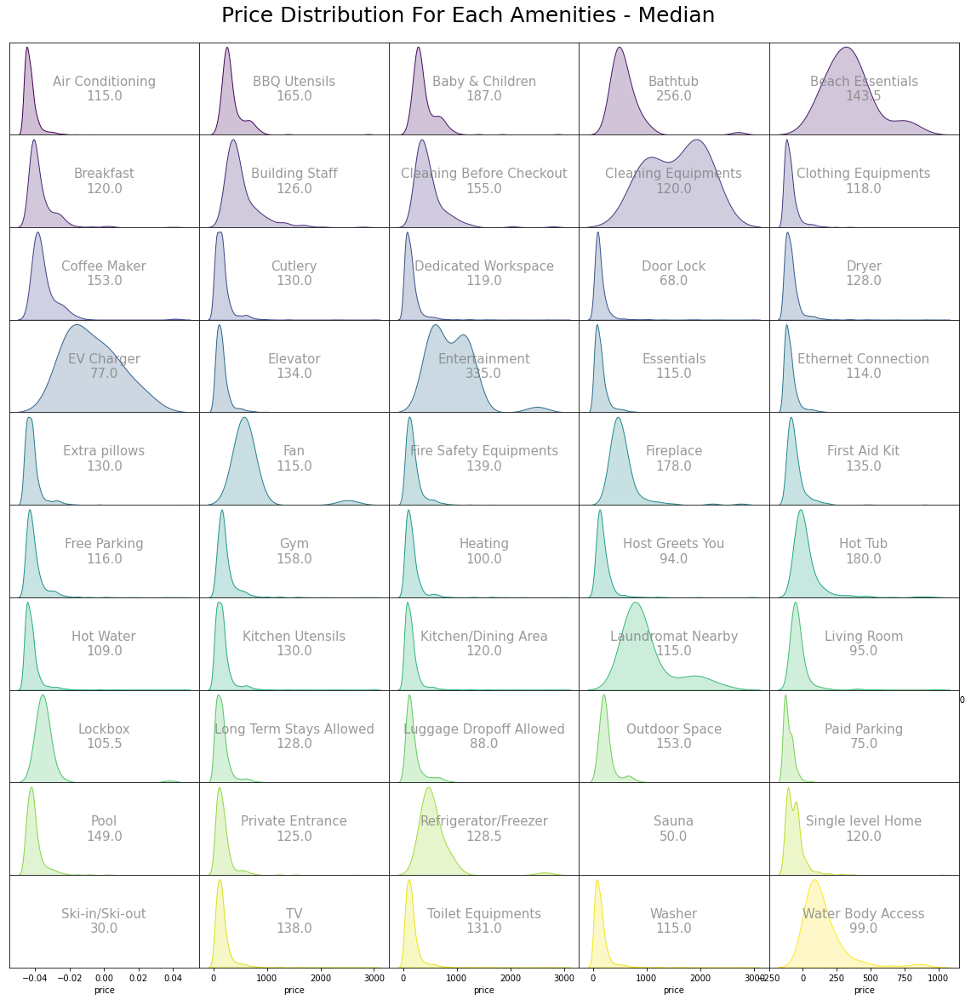

In [130]:
fig, ax = plt.subplots(10, 5, figsize=(20, 20))
plt.subplots_adjust(hspace=0, wspace=0)
ax = ax.flatten()
cm = matplotlib.cm.get_cmap('viridis', 50)
for idx, x in enumerate(amenities.columns[:-1]):
    data = amenities[amenities[x] == 1]
    g = sns.kdeplot(x=data.price, fill=True, ax=ax[idx], color=cm(idx))
    
    mapping = {'Baby and Children Equipments': 'Baby & Children', 
               'Extra pillows, blankets or bed-linen': 'Extra pillows'}
    text = mapping.get(x) if x in mapping else x
    text += f'\n{data.price.median()}'
    g.text(x=0.5, y=0.5, s=text, fontdict={'fontsize':15}, transform=ax[idx].transAxes, 
           ha='center', va='center', color='gray', alpha=0.8)
    g.set_yticklabels([])
    g.set_ylabel('')
    g.set_yticks([])
    
fig.suptitle('Price Distribution For Each Amenities - Median', y=0.91, fontsize=25)
plt.show()

In [133]:
fig.savefig(PATH+'insight-5-plot.png')

## What is the percentage of each room type in each neighbourhood?

In [39]:
byRoom = df_dict['listings'].groupby('room_type').agg(count=('id', 'count'))
labels = byRoom.index
values = byRoom['count']

data = go.Pie(labels=labels, values=values, hole=.5, textinfo='percent')
layout = go.Layout(title_text='Percentage of Each Room Type', title_x=0.45)
fig = go.Figure(data=data, layout=layout)
fig.show()

## Room type in each neighbourhood

In [40]:
[['domain']*2]*3

[['domain', 'domain'], ['domain', 'domain'], ['domain', 'domain']]

In [41]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import itertools

fig = make_subplots(rows=3, cols=2, specs=[[{'type':'domain'}]*2]*3, 
                    subplot_titles=df_dict['listings'].neighbourhood_group_cleansed.unique(), 
                    horizontal_spacing=0.4)
raw = df_dict['listings']
idx = list(itertools.product(range(1,4), range(1,3)))

for i, group in enumerate(df_dict['listings'].neighbourhood_group_cleansed.unique()):
    df = raw[raw.neighbourhood_group_cleansed == group].groupby('room_type').agg(count=('id', 'count'))
    labels = df.index
    values = df['count']

    data = go.Pie(labels=labels, values=values, hole=.5, textinfo='percent')
    fig.add_trace(data, row=idx[i][0], col=idx[i][1])

fig.update_layout(height=800)
fig.show()